In [1]:
# import kagglehub

# # Download latest version
# path = kagglehub.dataset_download("patrickfleith/nasa-battery-dataset")

# print("Path to dataset files:", path)

100%|██████████| 228M/228M [02:51<00:00, 1.40MB/s] 


Extracting files...
Path to dataset files: C:\Users\ASUS\.cache\kagglehub\datasets\patrickfleith\nasa-battery-dataset\versions\2


In [1]:
import pandas as pd

metadata = pd.read_csv("cleaned_dataset\metadata.csv")

<>:3: SyntaxWarning: invalid escape sequence '\m'
<>:3: SyntaxWarning: invalid escape sequence '\m'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_11760\3798147813.py:3: SyntaxWarning: invalid escape sequence '\m'
  metadata = pd.read_csv("cleaned_dataset\metadata.csv")


In [3]:
metadata.head()

,type,start_time,ambient_temperature,battery_id,test_id,uid,filename,Capacity,Re,Rct
0,discharge,[2010. 7. 21. 15. 0. ...,4,B0047,0,1,00001.csv,1.6743047446975208,NaN,NaN
1,impedance,[2010. 7. 21. 16. 53. ...,24,B0047,1,2,00002.csv,NaN,0.05605783343888099,0.20097016584458333
2,charge,[2010. 7. 21. 17. 25. ...,4,B0047,2,3,00003.csv,NaN,NaN,NaN
3,impedance,[2010 7 21 20 31 5],24,B0047,3,4,00004.csv,NaN,0.05319185850921101,0.16473399914864734
4,discharge,[2.0100e+03 7.0000e+00 2.1000e+01 2.1000e+01 2...,4,B0047,4,5,00005.csv,1.5243662105099023,NaN,NaN


In [4]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import plotly.graph_objects as plt

In [5]:
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7565 entries, 0 to 7564
Data columns (total 10 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   type                 7565 non-null   object
 1   start_time           7565 non-null   object
 2   ambient_temperature  7565 non-null   int64 
 3   battery_id           7565 non-null   object
 4   test_id              7565 non-null   int64 
 5   uid                  7565 non-null   int64 
 6   filename             7565 non-null   object
 7   Capacity             2794 non-null   object
 8   Re                   1956 non-null   object
 9   Rct                  1956 non-null   object
dtypes: int64(3), object(7)
memory usage: 591.1+ KB


In [8]:
metadata.shape

(7565, 10)

In [29]:
metadata['start_time'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 7565 entries, 0 to 7564
Series name: start_time
Non-Null Count  Dtype 
--------------  ----- 
7565 non-null   object
dtypes: object(1)
memory usage: 59.2+ KB


In [84]:
import pandas as pd
import plotly.express as px

# Initialize an empty DataFrame for combined data
combined_data = pd.DataFrame()

# Define battery ID groups and types
battery_id_groups = [
    ['B0005', 'B0006', 'B0007', 'B0018'],
    ['B0025', 'B0026', 'B0027', 'B0028'],
    ['B0040', 'B0039', 'B0038']
]
types = ['charge', 'discharge', 'impedance']

# Loop through battery ID groups and types
for data_type in types:
    for battery_ids in battery_id_groups:
        # Filter metadata for the current battery IDs and type
        filtered_metadata = metadata[
            metadata[['Re', 'Rct']].notna().all(axis=1) &  # Ensure Re and Rct are valid
            metadata['battery_id'].isin(battery_ids) &  # Filter for battery IDs
            metadata['type'].isin([data_type])  # Filter for the current type
        ]

        # Skip if no data is available for the current filter
        if filtered_metadata.empty:
            print(f"No data available for {data_type} and battery IDs {battery_ids}.")
            continue

        # Initialize an empty DataFrame for the current data type
        data_type_data = pd.DataFrame()

        # Iterate through the filtered metadata and read corresponding CSV files
        for i in filtered_metadata.index:
            path = f"cleaned_dataset/data/{filtered_metadata.loc[i, 'filename']}"
            data = pd.read_csv(path)

            # Add metadata columns to the data
            for col in ['battery_id', 'test_id', 'ambient_temperature', 'start_time', 'Capacity', 'Re', 'Rct']:
                data[col] = filtered_metadata.loc[i, col]
            
            # Append to combined_data
            combined_data = pd.concat([combined_data, data], ignore_index=True)

        # Ensure combined_data is not empty
        if combined_data.empty:
            print(f"No valid data found for plotting {data_type} and battery IDs {battery_ids}.")
            continue

        # Melt the DataFrame for plotting Re and Rct in facets
        melted_data = combined_data.melt(
            id_vars=['test_id', 'battery_id'], 
            value_vars=['Re', 'Rct'], 
            var_name='Parameter', 
            value_name='Value'
        )

        # Create the visualization for the current data type
        fig = px.line(
            melted_data,
            x='test_id',
            y='Value',
            color='battery_id',
            facet_row='Parameter',
            title=f'Electrolyte and Charge Transfer Resistance vs. Cycle Count ({data_type.capitalize()})',
            labels={
                'test_id': 'Cycle Count',
                'Value': 'Resistance (Ohms)',
                'battery_id': 'Battery ID',
                'Parameter': 'Resistance Type'
            }
        )

        # Enhance the figure layout
        fig.update_layout(
            height=800,
            template='simple_white',
            title_font=dict(size=18, family='Arial', color='black'),
            xaxis_title='Cycle Count',
            yaxis_title='Resistance (Ohms)'
        )

        # Show the figure for the current data type
        fig.show()


No data available for charge and battery IDs ['B0005', 'B0006', 'B0007', 'B0018'].
No data available for charge and battery IDs ['B0025', 'B0026', 'B0027', 'B0028'].
No data available for charge and battery IDs ['B0040', 'B0039', 'B0038'].
No data available for discharge and battery IDs ['B0005', 'B0006', 'B0007', 'B0018'].
No data available for discharge and battery IDs ['B0025', 'B0026', 'B0027', 'B0028'].
No data available for discharge and battery IDs ['B0040', 'B0039', 'B0038'].


In [91]:
fig = px.line(
    combined_data.melt(id_vars=['start_time'], value_vars=['Sense_current', 'Battery_current']),
    x='start_time',
    y='value',
    color='variable',
    title='Current Trends Over Time',
    labels={'start_time': 'Time', 'value': 'Current (A)', 'variable': 'Current Type'}
)
fig.show()


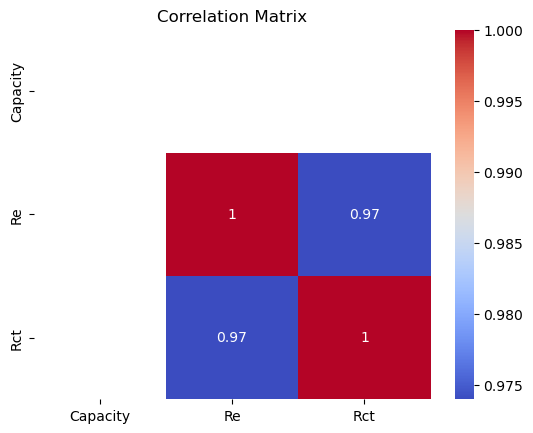

In [96]:
import seaborn as sns
import matplotlib.pyplot as plt

correlation_matrix = combined_data[['Capacity', 'Re', 'Rct']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [83]:
# Filter impedance data and ensure a copy is made
impedance_data = metadata[
    (metadata['type'] == 'impedance') & 
    metadata[['Re', 'Rct']].notna().all(axis=1)
].copy()

# Convert 'Re' and 'Rct' columns to numeric values
impedance_data['Re'] = pd.to_numeric(impedance_data['Re'], errors='coerce')
impedance_data['Rct'] = pd.to_numeric(impedance_data['Rct'], errors='coerce')

# Drop rows with NaN values in 'Re' or 'Rct' after conversion
impedance_data = impedance_data.dropna(subset=['Re', 'Rct'])

# Sort the data by 'start_time'
impedance_data = impedance_data.sort_values(by='start_time')

# Check if data is available for plotting
if impedance_data.empty:
    print("No valid data available for plotting.")
else:
    # Create a line plot for Electrolyte Resistance (Re) vs Time
    fig1 = px.line(
        impedance_data, 
        x='start_time', 
        y='Re',
        title='Electrolyte Resistance (Re) Over Time',
        labels={
            'start_time': 'Time', 
            'Re': 'Electrolyte Resistance (Ohms)'
        },
        markers=True,  # Add markers for clarity
    )

    # Further enhancements
    fig1.update_traces(
        line=dict(color='royalblue', width=2.5),  # Set line color and thickness
        marker=dict(size=8, color='red', symbol='circle'),  # Highlight data points with red markers
    )

    fig1.update_layout(
        xaxis=dict(
            tickangle=45,  # Rotate x-axis labels for better readability
            title_font=dict(size=14, family='Arial', color='black'),  # Improve x-axis title styling
            tickfont=dict(size=12, family='Arial', color='black'),  # Improve x-axis tick font
            showgrid=False,  # Remove unnecessary gridlines
            zeroline=False,
        ),
        yaxis=dict(
            title='Electrolyte Resistance (Ohms)',
            title_font=dict(size=14, family='Arial', color='black'),  # Y-axis title styling
            tickfont=dict(size=12, family='Arial', color='black'),  # Improve y-axis tick font
            gridcolor='lightgrey',  # Lighten the gridlines for a cleaner look
            tickformat='.4f',  # Format decimal places
        ),
        title=dict(
            text='Electrolyte Resistance (Re) Over Time',
            font=dict(size=20, family='Arial Black', color='darkblue'),  # Make title stand out
            x=0.5,  # Center the title
        ),
        template='simple_white',  # Use a clean white background
        hovermode='x unified',  # Combine hover info across all points
        width=1000,  # Increase the graph width
        height=600,  # Adjust the height for better proportions
    )

    # Add annotations for Re
    min_re = impedance_data['Re'].min()
    max_re = impedance_data['Re'].max()
    min_time_re = impedance_data.loc[impedance_data['Re'] == min_re, 'start_time'].iloc[0]
    max_time_re = impedance_data.loc[impedance_data['Re'] == max_re, 'start_time'].iloc[0]

    fig1.add_annotation(
        x=min_time_re, y=min_re,
        text=f"Min Re: {min_re:.4f}",
        showarrow=True,
        arrowhead=2,
        ax=0, ay=-40,
        bgcolor="lightgreen",
        font=dict(size=12, color="black")
    )

    fig1.add_annotation(
        x=max_time_re, y=max_re,
        text=f"Max Re: {max_re:.4f}",
        showarrow=True,
        arrowhead=2,
        ax=0, ay=-40,
        bgcolor="salmon",
        font=dict(size=12, color="black")
    )

    # Add annotations for Rct
    min_rct = impedance_data['Rct'].min()
    max_rct = impedance_data['Rct'].max()
    min_time_rct = impedance_data.loc[impedance_data['Rct'] == min_rct, 'start_time'].iloc[0]
    max_time_rct = impedance_data.loc[impedance_data['Rct'] == max_rct, 'start_time'].iloc[0]

    fig1.add_annotation(
        x=min_time_rct, y=min_rct,
        text=f"Min Rct: {min_rct:.4f}",
        showarrow=True,
        arrowhead=2,
        ax=0, ay=40,
        bgcolor="lightblue",
        font=dict(size=12, color="black")
    )

    fig1.add_annotation(
        x=max_time_rct, y=max_rct,
        text=f"Max Rct: {max_rct:.4f}",
        showarrow=True,
        arrowhead=2,
        ax=0, ay=40,
        bgcolor="orange",
        font=dict(size=12, color="black")
    )

    # Display the updated figure
    fig1.show()


In [36]:
# Calculate Battery Impedance
impedance_data['Battery_Impedance'] = impedance_data['Re'] + impedance_data['Rct']

# Create the combined figure
fig_combined = plt.Figure()

# Add Battery Impedance trace
fig_combined.add_trace(plt.Scatter(
    x=impedance_data['start_time'], 
    y=impedance_data['Battery_Impedance'],
    mode='lines', 
    name='Battery Impedance (Re + Rct)'
))

# Add Charge Transfer Resistance trace
fig_combined.add_trace(plt.Scatter(
    x=impedance_data['start_time'], 
    y=impedance_data['Rct'],
    mode='lines', 
    name='Charge Transfer Resistance (Rct)'
))

# Enhance the graph with improvements
fig_combined.update_layout(
    xaxis=dict(
        tickangle=45,  # Rotate x-axis labels for clarity
        tickformat='%Y-%m-%d'  # Format dates if applicable
    ),
    yaxis=dict(
        title='Impedance (Ohms)',
        tickformat='.4f'  # Round y-axis values to 4 decimal places
    ),
    title=dict(
        text='Impedance Over Time',
        x=0.5,  # Center-align the title
        font=dict(size=18)  # Increase title font size
    ),
    template='plotly_white',  # Clean layout
)

# Display the combined figure
fig_combined.show()

In [39]:
metadata['battery_id'].value_counts().unique()

array([616, 486, 319, 275, 253, 252, 184, 163, 137, 122,  97,  80,  62],
      dtype=int64)

In [77]:
discharge_data = metadata[metadata['type'] == 'discharge']

fig = px.line(discharge_data, x='test_id', y='Capacity', color='battery_id',
              title='Battery Capacity vs. Cycle Count',
              labels={'test_id': 'Cycle Count', 'Capacity': 'Capacity (Ah)', 'battery_id': 'Battery ID'})
fig.show()

In [78]:
impedance_data = metadata[metadata['type'] == 'impedance']
fig1 = px.line(impedance_data, x='test_id', y='Re', color='battery_id',
               title='Electrolyte Resistance (Re) vs. Cycle Count',
               labels={'test_id': 'Cycle Count', 'Re': 'Electrolyte Resistance (Ohms)', 'battery_id': 'Battery ID'})
fig1.show()

fig2 = px.line(impedance_data, x='test_id', y='Rct', color='battery_id',
               title='Charge Transfer Resistance (Rct) vs. Cycle Count',
               labels={'test_id': 'Cycle Count', 'Rct': 'Charge Transfer Resistance (Ohms)', 'battery_id': 'Battery ID'})
fig2.show()

In [79]:
# Plot 1: Capacity vs. Cycle Count at different temperatures
fig_temp = px.line(discharge_data, x='test_id', y='Capacity', color='ambient_temperature',
                   title='Capacity vs. Cycle Count at Different Temperatures',
                   labels={'test_id': 'Cycle Count', 'Capacity': 'Capacity (Ah)', 'ambient_temperature': 'Ambient Temperature (°C)'})
fig_temp.show()



In [2]:
# List of all possible registration numbers
all_reg_numbers = set(range(2448501, 2448560))

# List of registration numbers that have responded
responded_numbers = {
   2448539, 2448524, 2448510, 2448550, 2448520, 2448536, 2448531, 2448503, 
    2448518, 2448544, 2448519, 2448558, 2448534, 2448501, 2448526, 2448559, 
    2448556, 2448528, 2448525, 2448551, 2448513, 2448506, 2448529, 2448511, 
    2448521, 2448516, 2448537, 2448523, 2448502, 2448535, 2448543, 2448533, 
    2448522, 2448509, 2448508, 2448541, 2448514, 2448540, 2448538, 2448555, 
    2448552, 2448546, 2448554, 2448549, 2448553, 2448505, 2448542, 2448530, 
    2448515, 2448557, 2448547, 2448517, 2448545, 2448527,2448512
}



# Find the registration numbers that have not responded
not_responded_numbers = all_reg_numbers - responded_numbers

print("Registration numbers that have not responded yet:")
print(sorted(not_responded_numbers))
print("\nTotal number of registration numbers that have not responded:", len(not_responded_numbers))


Registration numbers that have not responded yet:
[2448504, 2448507, 2448532, 2448548]

Total number of registration numbers that have not responded: 4
